In [71]:
import time

import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from model import Model
from femnist.cnn import ClientModel
from utils.model_utils import read_data

pd.set_option('display.max_columns', 500)

In [15]:
IMAGE_SIZE = 28

In [16]:
users, groups, train_data, test_data = read_data('../../../femnist-data/large/train', '../../../femnist-data/large/test')

In [132]:
df = pd.DataFrame.from_dict(train_data)

In [133]:
pd.DataFrame.from_dict(train_data).iloc[1].map(len).sum()

705601

In [134]:
 pd.DataFrame.from_dict(test_data).iloc[1].map(len).sum()

80132

a = np.array(df.head(2).x.values[1])
a.shape

x = np.array(test_data['f2558_96']['x'][2])
x = a.reshape(28,28)

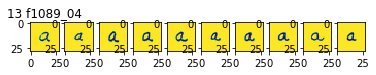

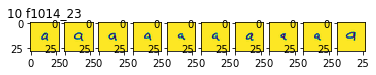

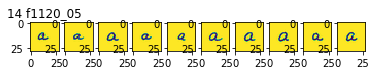

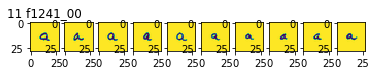

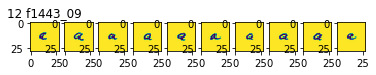

...

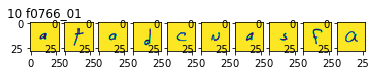

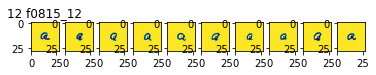

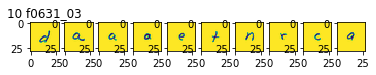

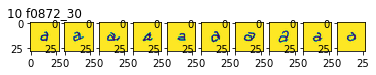

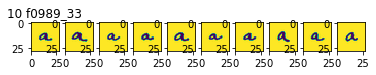

3417
0
0


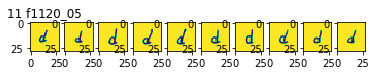

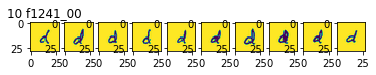

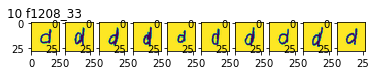

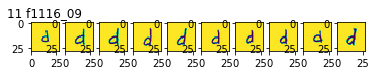

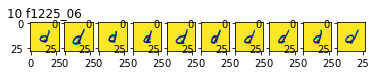

...

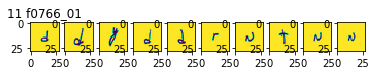

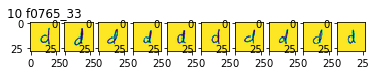

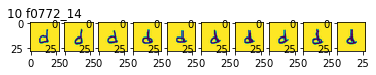

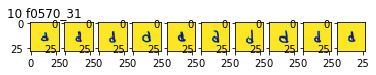

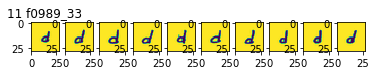

1956


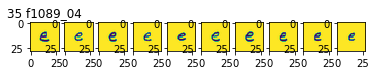

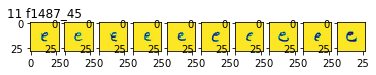

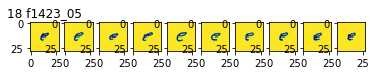

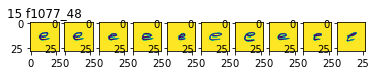

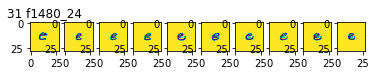

...

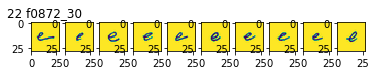

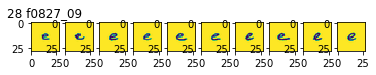

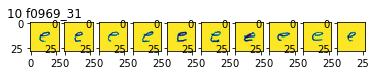

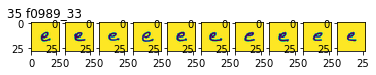

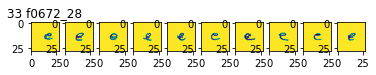

20856
0
0


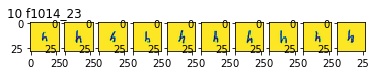

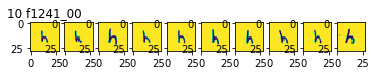

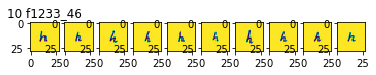

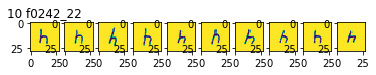

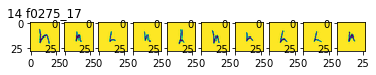

...

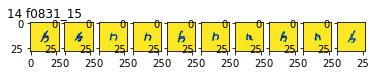

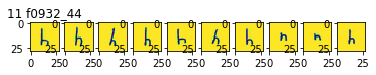

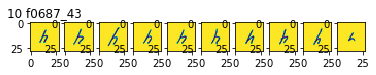

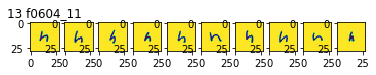

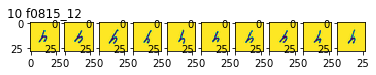

976


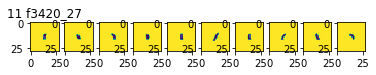

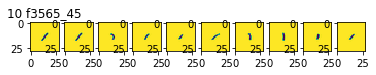

21
0
0


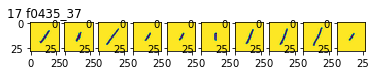

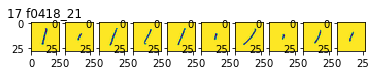

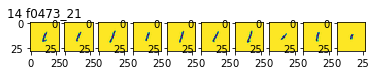

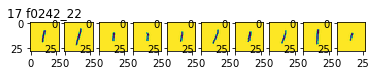

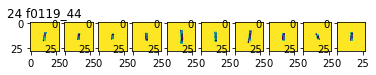

...

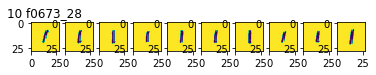

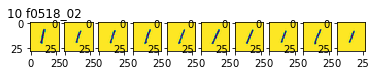

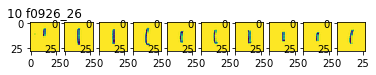

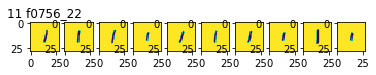

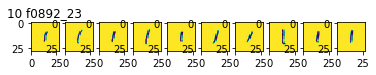

8148
0


6121


In [21]:
for i in range(36,50):
    sum = 0
    for user in test_data.keys():
        df = pd.DataFrame.from_dict(train_data[user])
        df = df[df.y == i]
        if df.empty or df.shape[0] < 10:
            continue
        sum += df.shape[0]
        fig, ax = plt.subplots(1, 10)
        ax[0].set_title("{} {}".format(df.shape[0], user))
        for k in range(0,10):
            ax[k].imshow(np.array(df.x.values[k]).reshape(28,28))
        plt.show()
        time.sleep(0.001)
    print(sum)

In [47]:
sum = 0
i = 53
CHARS_PER_USER = 3
for user in test_data.keys():
    df = pd.DataFrame.from_dict(train_data[user])
    df = df[df.y == i]
    if df.empty or df.shape[0] < CHARS_PER_USER:
        continue
    sum += df.shape[0]
    fig, ax = plt.subplots(1, CHARS_PER_USER)
    ax[0].set_title("{} {}".format(df.shape[0], user))
    for k in range(0,CHARS_PER_USER):
        ax[k].imshow(np.array(df.x.values[k]).reshape(28,28))
    plt.show()
    time.sleep(0.001)
print(sum)

11811


'f0631_03' hat ein komisches a – fehler in den Daten (? – sehr wahrscheinlich)

In [78]:
import string
def class_id_to_char (class_id):
    if class_id<10:
        return str(class_id)
    if class_id<36:
        return string.ascii_uppercase[class_id-10]
    return string.ascii_lowercase[class_id-36]

In [137]:
df = pd.DataFrame.from_dict(train_data)
df = df.iloc[1].map(lambda y_list: np.histogram(y_list, bins=np.arange(63))[0])
df = pd.DataFrame(df.to_list())
df = df.rename(columns=class_id_to_char)

#### Number of Writers that written all Letters at least once

`df[df!=0]` sets letters that have never been written by a writer to NaN, making counting values more meaningful.

In [139]:
df[df != 0].dropna().shape[0]

7

#### Number of letters per writer

In [148]:
df[df != 0].describe()

,0,1,2,3,4,5,6,7,8,9,A,B,C,D,E,F,G,H,I,J,K,L,M,N,O,P,Q,R,S,T,U,V,W,X,Y,Z,a,b,c,d,e,f,g,h,i,j,k,l,m,n,o,p,q,r,s,t,u,v,w,x,y,z
count,3483.000000,3483.000000,3481.000000,3483.000000,3483.000000,3475.000000,3482.000000,3482.000000,3483.000000,3480.000000,2930.000000,2891.000000,3095.000000,2842.000000,2601.000000,2927.000000,2572.000000,2612.000000,3159.000000,2854.000000,2434.000000,3060.000000,3011.000000,2973.000000,3054.000000,3056.000000,2640.000000,2754.00000,3039.000000,2904.000000,3039.000000,2946.000000,3025.000000,2786.000000,2882.000000,2715.000000,2900.000000,2972.000000,2740.000000,3001.000000,2943.000000,2587.000000,2524.000000,3011.000000,2337.000000,1883.000000,2582.000000,3133.000000,2673.000000,2912.000000,2746.000000,2450.000000,2364.000000,2918.000000,2696.000000,2978.000000,2695.000000,2727.000000,2721.000000,2852.000000,2356.000000,2756.000000
mean,10.180017,11.233132,10.106866,10.338788,9.843813,9.249209,10.070075,10.602240,9.954637,9.996839,2.202730,1.359045,3.261066,1.607671,1.904268,3.058080,1.019051,1.233155,3.712251,1.353889,1.019721,1.656536,2.967785,2.759502,8.018009,2.694372,1.014773,1.83406,6.732478,3.330579,4.082264,1.603191,1.575537,1.017947,1.655101,1.018048,3.442069,1.743607,1.066058,3.375875,8.215087,1.029764,1.475436,2.889073,1.200685,1.033457,1.021301,4.920843,1.022447,3.875000,1.038602,1.022857,1.288071,4.754626,1.022255,5.988247,1.093135,1.096076,1.023521,1.023142,1.028862,1.018142
std,2.029233,1.987229,2.110745,2.020020,2.289064,2.625118,2.125001,1.929533,2.208856,2.116944,2.720857,0.707183,3.007696,1.541124,4.025933,2.758577,0.136732,1.078854,3.626107,0.717458,0.139067,1.512292,2.523108,3.471042,8.386152,2.182398,0.123765,2.92435,7.078128,4.287572,3.756295,1.166471,0.873059,0.135459,1.107102,0.135888,3.595025,1.105756,0.269574,3.282683,10.578778,0.169969,0.722076,2.824722,0.603528,0.191327,0.147073,5.746740,0.148159,4.433039,0.201911,0.157460,0.558406,5.726910,0.150034,7.152417,0.315183,0.319820,0.151578,0.152694,0.174897,0.133490
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,9.000000,10.000000,9.000000,9.000000,9.000000,8.000000,9.000000,10.000000,9.000000,9.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
50%,10.000000,11.000000,10.000000,11.000000,10.000000,10.000000,10.000000,11.000000,10.000000,10.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
75%,12.000000,12.000000,12.000000,12.000000,11.000000,11.000000,12.000000,12.000000,12.000000,12.000000,2.000000,2.000000,5.000000,2.000000,1.000000,5.000000,1.000000,1.000000,5.000000,2.000000,1.000000,2.000000,5.000000,3.000000,16.000000,5.000000,1.000000,1.00000,14.000000,4.000000,8.000000,2.00000

#### Letters with the least writers of at least one

In [149]:
df[df != 0].describe().loc['count'].sort_values()

j    1883.0
i    2337.0
y    2356.0
q    2364.0
K    2434.0
p    2450.0
g    2524.0
G    2572.0
k    2582.0
f    2587.0
E    2601.0
H    2612.0
Q    2640.0
m    2673.0
u    2695.0
s    2696.0
Z    2715.0
w    2721.0
v    2727.0
c    2740.0
o    2746.0
R    2754.0
z    2756.0
X    2786.0
D    2842.0
x    2852.0
J    2854.0
Y    2882.0
B    2891.0
a    2900.0
      ...  
r    2918.0
F    2927.0
A    2930.0
e    2943.0
V    2946.0
b    2972.0
N    2973.0
t    2978.0
d    3001.0
M    3011.0
h    3011.0
W    3025.0
U    3039.0
S    3039.0
O    3054.0
P    3056.0
L    3060.0
C    3095.0
l    3133.0
I    3159.0
5    3475.0
9    3480.0
2    3481.0
7    3482.0
6    3482.0
4    3483.0
3    3483.0
8    3483.0
1    3483.0
0    3483.0
Name: count, Length: 62, dtype: float64

In [7]:
cm = ClientModel(0,0.0003, 62)

Instructions for updating:
Use keras.layers.conv2d instead.
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use keras.layers.max_pooling2d instead.
Instructions for updating:
Use keras.layers.dense instead.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Use tf.compat.v1.graph_util.remove_training_nodes


In [8]:
cm.train()

TypeError: train() missing 1 required positional argument: 'data'